In [1]:
import sys
sys.path.append('/mnt/Work/LaGonaveFM/') # or use path
sys.path.append('/home/aesgeorges/LaGonaveFM/')
from codebase.figures import *
from codebase.tools import *

import cmocean
import numpy as np
import netCDF4 as netcdf
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from tqdm import tqdm
from kalpana.plotting import plot_nc
from kalpana.export import fort14togdf
from kalpana.ADCIRC_tools import extract_ts_from_nc
import cartopy.crs as ccrs
import cartopy.feature as cf
import matplotlib as mpl
from matplotlib import rcParams

## Model Setup

In [2]:
plt.rcParams.update({
    'font.size': 18,
    "text.usetex": True,
    })

In [3]:
sim_dir_mangrove = '../sims/Gonave_Surge_mangrove/'
sim_dir_nomangrove = '../sims/Gonave_Surge_nomangrove/'
sim_dir_mangrove_rehab = '../sims/Gonave_Surge_rehab_mangrove/'

'Grand-Pierre Bay Mangrove Forest Refinements'

In [4]:
from shapely.geometry import shape
import geopandas as gpd
import fiona

retreats = ['r0', 'r1', 'r2', 'r3']
covers_gdf = gpd.GeoDataFrame(index=retreats, columns=['geometry'])

cover_path_tails = ['_retreat_light.shp', '_retreat_medium.shp', '_retreat_heavy.shp']
cover_root = '../datasets/mangrove_covers/refined/mangrove_polygon'

base_cover_path = '../datasets/mangrove_covers/refined/base/mangrove_polygon_refined.shp'
with fiona.open(base_cover_path, 'r') as src:
        base_cover = pd.DataFrame([feature['properties'] for feature in src])
        base_cover['geometry'] = [shape(feature['geometry']) for feature in src]
covers_gdf.iloc[0] = base_cover.iloc[0]['geometry']

for i, retreat in enumerate(cover_path_tails):
    path = f'{cover_root}{retreat}'
    with fiona.open(path, 'r') as src:
        cover = pd.DataFrame([feature['properties'] for feature in src])
        cover['geometry'] = [shape(feature['geometry']) for feature in src]
    cover_gdf = gpd.GeoDataFrame(cover, geometry='geometry')
    covers_gdf.iloc[i+1] = cover['geometry'].iloc[0]  # Assuming each retreat has one geometry

In [11]:
fig, ax = plt.subplots(figsize=(12,12), dpi=800, subplot_kw={'projection': ccrs.PlateCarree()})
mesh = fort14togdf(sim_dir_mangrove+'/fort.14', epsgIn=4326, epsgOut=4326, fileintype='fort.14')
mesh.plot(ax=ax, color='lightblue', edgecolor='black', linewidth=0.4, alpha=1.)
ax.grid(True, which='both', linestyle='--', linewidth=0.4, color='black', alpha=0.7)
#ax.set_title('Grand-Pierre Bay Mangrove Forest Refinements')

ax.set_xlim(-72.85, -72.6)
ax.set_ylim(19.25, 19.45)

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlocator = mpl.ticker.MaxNLocator(nbins=5)
gl.ylocator = mpl.ticker.MaxNLocator(nbins=5)

coast = cf.GSHHSFeature(scale='full')
#ax.add_feature(coast)

cover_base = gpd.GeoSeries([covers_gdf.loc[f'r0']['geometry']])

cover = gpd.GeoSeries([covers_gdf.loc[f'r0']['geometry']])

cover_base.plot(ax=ax, edgecolor='black', facecolor='none', linestyle='--', zorder=10, linewidth=0.1)
cover.plot(ax=ax, edgecolor='red', facecolor='red', alpha=0.1, linestyle='-', zorder=10, linewidth=0.3)
cover.plot(ax=ax, edgecolor='red', facecolor='none', linestyle='-', zorder=10, linewidth=0.3)

rcParams.update({
    'font.size': 18,
    'font.family': 'serif',
    'font.serif': ['Computer Modern Roman'],
    "text.usetex": True,
})

plt.savefig('/mnt/Work/mangrove-thesis/sitemaps/gpbay_mesh.png', bbox_inches='tight', dpi=800)

'Gulf of Gonâve and Windward Passage Model Domain'

In [5]:
%matplotlib inline
from matplotlib import rcParams
import matplotlib.pyplot as plt
import cartopy.feature as cf

# Set font preferences (do this before creating the map)
# Create EOmaps object instead of plt.subplots

rcParams.update({
    'font.size': 18,
    'font.family': 'serif',
    'font.serif': ['Computer Modern Roman'],
    "text.usetex": True,
})

fig, ax = plt.subplots(figsize=(12,12), dpi=800, subplot_kw={'projection': ccrs.PlateCarree()})

mesh.plot(ax=ax, color='lightblue', edgecolor='black', linewidth=0.3, alpha=1.)

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlocator = mpl.ticker.MaxNLocator(nbins=5)
gl.ylocator = mpl.ticker.MaxNLocator(nbins=5)

rect = plt.Rectangle(
    (-72.85, 19.25),  # lower left corner
    0.25,             # width: -72.6 - (-72.85)
    0.20,             # height: 19.45 - 19.25
    linewidth=1,
    edgecolor='red',
    facecolor='none'
)
ax.add_patch(rect)

ax.set_extent([-76.8, -71.9, 16.8, 20.5])

coast = cf.GSHHSFeature(scale='full')
ax.add_feature(coast)

rcParams.update({
    'font.size': 18,
    'font.family': 'serif',
    'font.serif': ['Computer Modern Roman'],
    "text.usetex": True,
})

#plt.savefig('/mnt/Work/mangrove-thesis/sitemaps/gonave_windward_mesh.png', bbox_inches='tight', dpi=800)

## Hurricane Tracks

In [6]:
root_mod = '../sims/Gonave_SLR_mangrove/S0/'
root = '../staging/runs/Matthew2016_EC95d/'
fort22path_base = root + 'fort.22'
fort22path_mod = root_mod + 'fort.22'

In [7]:
df = pd.read_csv(fort22path_base, header=None)

lat = 0.1 * df[6].str.strip().str.replace('N', '', regex=False).astype(float)
lon = -0.1 * df[7].str.strip().str.replace('W', '', regex=False).astype(float)

times = df[2]

In [8]:
df_mod = pd.read_csv(fort22path_mod, header=None)

lat_mod = 0.1 * df_mod[6].str.strip().str.replace('N', '', regex=False).astype(float)
lon_mod = -0.1 * df_mod[7].str.strip().str.replace('W', '', regex=False).astype(float)

times_mod = df_mod[2]

In [9]:
lon_test_1 = lon + 1.7
lon_test_2 = lon + 1.5
lon_test_3 = lon + 1.3

lons = [lon_test_1, lon_test_2, lon_test_3]

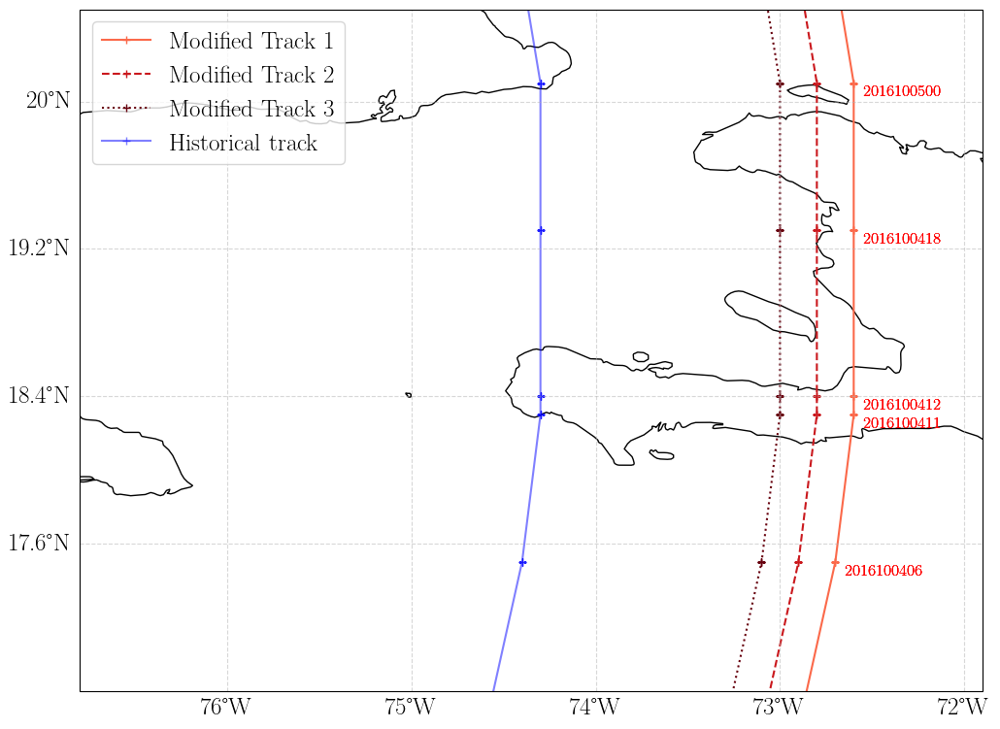

In [10]:
fig, ax = plt.subplots(figsize=(12,12), subplot_kw={'projection': ccrs.PlateCarree()})

custom_styles = ['solid', '--', ':']
colors = plt.get_cmap('Reds')(np.linspace(0.5, 1, 3))
for i, lon_t in enumerate(lons):
    ax.plot(lon_t, lat_mod, transform=ccrs.PlateCarree(), marker='+', linestyle=custom_styles[i], color=colors[i], label=f'Modified Track {i+1}')

#ax.plot(lon_mod, lat_mod, transform=ccrs.PlateCarree(), color='red', marker='+', label='Modified track')
ax.plot(lon, lat, transform=ccrs.PlateCarree(), alpha=0.5, color='blue', marker='+', label='Historical track')
ax.legend()
ax.coastlines()

for x, y, t in zip(lon_mod, lat_mod, times_mod):
    ax.text(x + .05, y - .07, str(t), transform=ccrs.PlateCarree(), fontsize=12, color='red', clip_on=True)

ax.set_extent([-76.8, -71.9, 16.8, 20.5])


gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlocator = mpl.ticker.MaxNLocator(nbins=5)
gl.ylocator = mpl.ticker.MaxNLocator(nbins=5)

#plt.savefig('/mnt/Work/mangrove-thesis/figures/hurricane_tracks.png', bbox_inches='tight', dpi=800)

In [11]:
track_distance_deg = np.sqrt((lon_mod - lon)**2 + (lat_mod - lat)**2)
track_distance_deg[10:].mean()
print(f"Mean distance between modified and historical tracks: {track_distance_deg[10:].mean():.4f} degrees")

Mean distance between modified and historical tracks: 1.7000 degrees


In [38]:
root_t2 = '../sims/Gonave_SLR_track3/Gonave_SLR_mangrove/S0/'
path = f'{root_t2}/hotstart/fort.63.nc'
path_hurr = f'{root_t2}/hotstart/fort.73.nc'
path_74 = f'{root_t2}/hotstart/fort.74.nc'
f63 = netcdf.Dataset(path, 'r')
f73 = netcdf.Dataset(path_hurr, 'r')
f74 = netcdf.Dataset(path_74, 'r')

In [39]:
df_vis = pd.read_csv(f'{root_t2}fort.22', header=None)

lat_vis = 0.1 * df_vis[6].str.strip().str.replace('N', '', regex=False).astype(float)
lon_vis = -0.1 * df_vis[7].str.strip().str.replace('W', '', regex=False).astype(float)

times_vis = df_vis[2]

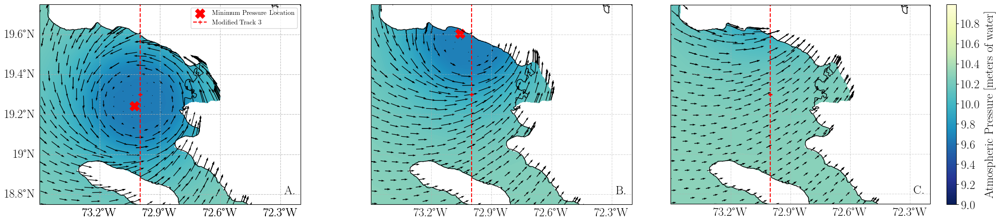

In [40]:
fig, axes = plt.subplots(1, 3, figsize=(22,5), subplot_kw={'projection': ccrs.PlateCarree()}, sharey=True)

unit = f73['pressure'].units

cbar_flgs = [0,0,1]
timesteps = [61,62,63]
text_label = ['A.', 'B.', 'C.']

for i, ts in enumerate(timesteps):
    ax = plot_nc(f73, 'pressure', levels=np.arange(9, 11, 0.01), background_map=False, cbar=cbar_flgs[i], cb_label=f'Atmospheric Pressure [{unit}]', cmap='YlGnBu_r', ts=ts,
        ncvec=f74, dxvec=0.05, dyvec=0.05, vecsc=1000, ax=axes[i], fig=fig)

    axes[i].set_extent([-73.5, -72.2, 18.75, 19.75])
    coast = cf.GSHHSFeature(scale='full')
    ax.add_feature(coast)


    min_idx = f73['pressure'][ts].argmin()
    x_eye = f73['x'][min_idx]
    y_eye = f73['y'][min_idx]

    axes[i].scatter(x_eye, y_eye, s=200, color='red', marker='X', label='Minimum Pressure Location')

    axes[i].plot(lon_vis, lat_vis, transform=ccrs.PlateCarree(), marker='+', linestyle='--', color='red', label=f'Modified Track 3')
    # Place label at the bottom right corner of each subplot
    xlim = axes[i].get_xlim()
    ylim = axes[i].get_ylim()
    x_pos = xlim[1] - 0.02 * (xlim[1] - xlim[0])
    y_pos = ylim[0] + 0.04 * (ylim[1] - ylim[0])
    
    ax.text(x_pos, y_pos, f"{text_label[i]}", transform=axes[i].transData, fontsize=18, color='black', ha='right', va='bottom', clip_on=True, fontweight='bold')

    gl = axes[i].gridlines(crs=ccrs.PlateCarree(), draw_labels=True, alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    gl.xlocator = mpl.ticker.MaxNLocator(nbins=5)
    gl.ylocator = mpl.ticker.MaxNLocator(nbins=5)

axes[0].legend(fontsize=10)
gl = axes[0].gridlines(crs=ccrs.PlateCarree(), draw_labels=True, alpha=0.5, linestyle='--')
gl.left_labels = True
gl.top_labels = False
gl.right_labels = False
gl.ylocator = mpl.ticker.MaxNLocator(nbins=5)
gl.xlocator = mpl.ticker.MaxNLocator(nbins=5)


xlim = axes[0].get_xlim()
ylim = axes[0].get_ylim()
x_pos = 0.8
y_pos = 0.8
axes[0].text(x_pos, y_pos, "Track 3", transform=axes[i].transData, fontsize=18, color='black', ha='right', va='bottom', clip_on=True, fontweight='bold')

"""for x, y, t in zip(lon_mod, lat_mod, times_mod):
    ax.text(x + .08, y - .01, str(t), transform=ccrs.PlateCarree(), fontsize=14, color='red', clip_on=True)"""

plt.tight_layout(w_pad=0.6)

plt.savefig('/mnt/Work/mangrove-thesis/figures/hurricane_windfield_3.png', bbox_inches='tight', dpi=800)

## Mangrove Covers (On vs Off)

## Retreat Covers

In [ ]:
covers_gdf

,geometry
r0,"POLYGON ((-72.69583 19.39900, -72.69393 19.399..."
r1,"MULTIPOLYGON (((-72.71323 19.38336, -72.71325 ..."
r2,"MULTIPOLYGON (((-72.76563 19.27981, -72.76313 ..."
r3,"MULTIPOLYGON (((-72.77298 19.27977, -72.77288 ..."


In [12]:
colors

<module 'matplotlib.colors' from '/home/aesgeorges/.local/lib/python3.10/site-packages/matplotlib/colors.py'>

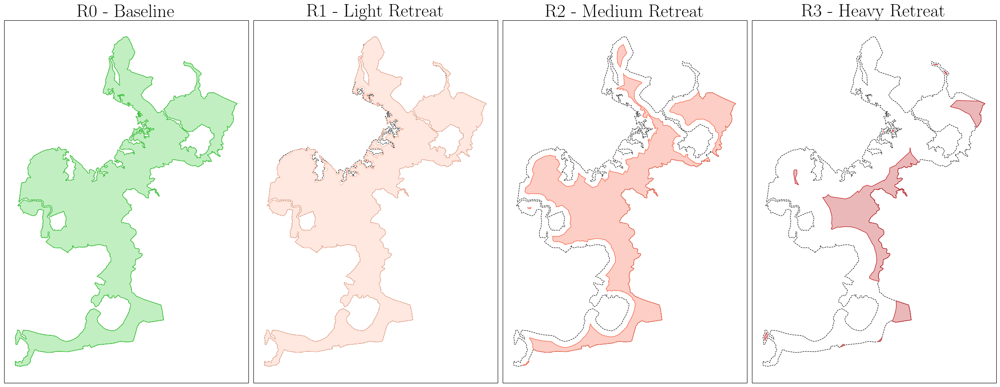

In [13]:
import rioxarray as rxr
from cmcrameri import cm as cmc

fig, axes = plt.subplots(1, 4, figsize=(24, 10), subplot_kw={'projection': ccrs.PlateCarree()}, constrained_layout=True)
axes = np.atleast_1d(axes)
    
colors = mpl.cm.Reds(np.linspace(0., 0.8, 4))
retreat_labels = ['Baseline', 'Light Retreat', 'Medium Retreat', 'Heavy Retreat']
cover_base = gpd.GeoSeries([covers_gdf.loc[f'r0']['geometry']])

cover = gpd.GeoSeries([covers_gdf.loc[f'r0']['geometry']])

cover_base.plot(ax=axes[0], edgecolor='black', facecolor='none', linestyle='--', zorder=10, linewidth=0.8)
cover.plot(ax=axes[0], edgecolor='limegreen', facecolor='limegreen', alpha=0.3, linestyle='-', zorder=10, linewidth=0.8)
cover.plot(ax=axes[0], edgecolor='limegreen', facecolor='none', linestyle='-', zorder=10, linewidth=0.8)
axes[0].set_title(f'R0 - {retreat_labels[0]}', fontsize=32)

for i in range(1, covers_gdf.shape[0]):
    cover = gpd.GeoSeries([covers_gdf.loc[f'r{i}']['geometry']])

    cover_base.plot(ax=axes[i], edgecolor='black', facecolor='none', linestyle='--', zorder=10, linewidth=0.8)
    cover.plot(ax=axes[i], edgecolor=colors[i], facecolor=colors[i], alpha=0.3, linestyle='-', zorder=10, linewidth=0.8)
    cover.plot(ax=axes[i], edgecolor=colors[i], facecolor='none', linestyle='-', zorder=10, linewidth=0.8)
    axes[i].set_title(f'R{i} - {retreat_labels[i]}', fontsize=32)

plt.savefig('/mnt/Work/mangrove-thesis/figures/mangrove_retreats.png', bbox_inches='tight', dpi=800)

In [ ]:
import rioxarray as rxr
from cmcrameri import cm as cmc

def plot_retreats(cover_base, cover, title_scene, title):
    fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={'projection': ccrs.PlateCarree()}, 
                    constrained_layout=True)
    
    colors = cmc.vikO(np.linspace(0.3, 0.8, 5))


    cities_gdf.plot(ax=ax, edgecolor='white', facecolor='gray', alpha=0.1, linestyle='--', zorder=10)
    cities_gdf.plot(ax=ax, edgecolor='white', facecolor='none', linestyle='--', zorder=10)
    cities = ['Desdunes', "L'Estere", 'Gonaives']

    cover_base.plot(ax=ax, edgecolor='black', facecolor='none', linestyle='--', zorder=10, linewidth=0.8)
    cover.plot(ax=ax, edgecolor='limegreen', hatch='++', facecolor='none', alpha=0.5, linestyle='-', zorder=10, linewidth=0.8)
    cover.plot(ax=ax, edgecolor='limegreen', facecolor='none', linestyle='-', zorder=10, linewidth=0.8)

    cover_loss = gpd.overlay(gpd.GeoDataFrame(geometry=cover), gpd.GeoDataFrame(geometry=cover_base), how='symmetric_difference')
    cover_loss.plot(ax=ax, edgecolor='none', hatch='///', facecolor='red', alpha=0., zorder=10)

    legend_patches = [
        mpatches.Patch(color='limegreen', edgecolor='limegreen', alpha=0.5, hatch=r'+', label='Mangrove Cover'),
        mpatches.Patch(facecolor='lightgrey', alpha=0.1, hatch=r'//////', label='Mangrove Cover Loss'),
        Line2D([0], [0], color='red', lw=2, label='Additional Flooding Area'),
    ]
    

    for x, y, label in zip(cities_gdf.geometry.centroid.x, cities_gdf.geometry.centroid.y, cities):
        t = ax.text(
            x, y, str(label),
            fontsize=14,
            color='white',
            ha='center',
            va='center',
            zorder=11,
        )
        t.set_path_effects([path_effects.Stroke(linewidth=1, foreground='black'),
                       path_effects.Normal()])

    ax.set_xlim(-72.8, -72.58)
    ax.set_ylim(19.23, 19.5)

    gl = ax.gridlines(draw_labels=True, alpha=0.5, linestyle='--', zorder=10) 
    gl.top_labels = False
    gl.right_labels = False

    ax.set_title(title, fontsize=18,  fontweight='bold')
    ax.legend(handles=legend_patches, loc='upper left', fontsize=18)

    
    plt.savefig(f"exports/figures/{title}.png", dpi=800, bbox_inches='tight', transparent=True)
    return diff_test